# **Building Music Recommendation System using Spotify Dataset**

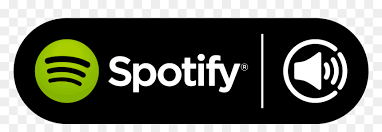

In this notebook, we have created Music Recommendation System using Spotify Dataset. To do this,we presented some of the visualization processes to understand data and done some EDA(Exploratory Data Analysis) so we can select features that are relevant to create a Recommendation System.

# **Import Libraries**

In [2]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

import warnings
warnings.filterwarnings("ignore")

# **Read Data**

In [5]:
data = pd.read_csv("./data/data.csv")
genre_data = pd.read_csv('./data/data_by_genres.csv')
year_data = pd.read_csv('./data/data_by_year.csv')

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 169909 entries, 0 to 169908
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   acousticness      169909 non-null  float64
 1   artists           169909 non-null  object 
 2   danceability      169909 non-null  float64
 3   duration_ms       169909 non-null  int64  
 4   energy            169909 non-null  float64
 5   explicit          169909 non-null  int64  
 6   id                169909 non-null  object 
 7   instrumentalness  169909 non-null  float64
 8   key               169909 non-null  int64  
 9   liveness          169909 non-null  float64
 10  loudness          169909 non-null  float64
 11  mode              169909 non-null  int64  
 12  name              169909 non-null  object 
 13  popularity        169909 non-null  int64  
 14  release_date      169909 non-null  object 
 15  speechiness       169909 non-null  float64
 16  tempo             16

In [7]:
genre_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2664 entries, 0 to 2663
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   genres            2664 non-null   object 
 1   acousticness      2664 non-null   float64
 2   danceability      2664 non-null   float64
 3   duration_ms       2664 non-null   float64
 4   energy            2664 non-null   float64
 5   instrumentalness  2664 non-null   float64
 6   liveness          2664 non-null   float64
 7   loudness          2664 non-null   float64
 8   speechiness       2664 non-null   float64
 9   tempo             2664 non-null   float64
 10  valence           2664 non-null   float64
 11  popularity        2664 non-null   float64
 12  key               2664 non-null   int64  
 13  mode              2664 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 291.5+ KB


In [8]:
year_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   year              100 non-null    int64  
 1   acousticness      100 non-null    float64
 2   danceability      100 non-null    float64
 3   duration_ms       100 non-null    float64
 4   energy            100 non-null    float64
 5   instrumentalness  100 non-null    float64
 6   liveness          100 non-null    float64
 7   loudness          100 non-null    float64
 8   speechiness       100 non-null    float64
 9   tempo             100 non-null    float64
 10  valence           100 non-null    float64
 11  popularity        100 non-null    float64
 12  key               100 non-null    int64  
 13  mode              100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


We are going to check for all the analysis with the target as **'popularity'**. Before going to do that let's check for the Feature Correlation by considering a few features and for that, I'm going to use the **yellowbrick** package. You can learn more about it from the [documentation](https://www.scikit-yb.org/en/latest/index.html).

# **Data Understanding by Visualization and EDA**

# **Music Over Time**

Using the data grouped by year, we can understand how the overall sound of music has changed from 1921 to 2020.

<AxesSubplot:xlabel='decade', ylabel='count'>

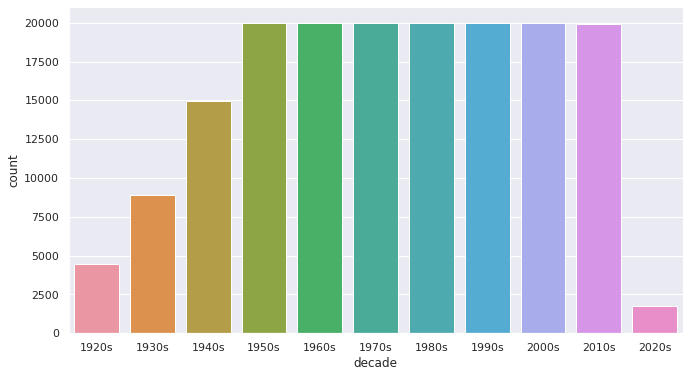

In [11]:
def get_decade(year):
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    return decade

data['decade'] = data['year'].apply(get_decade)

sns.set(rc={'figure.figsize':(11 ,6)})
sns.countplot(data['decade'])

In [12]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features)
fig.show()

# **Characteristics of Different Genres**

This dataset contains the audio features for different songs along with the audio features for different genres. We can use this information to compare different genres and understand their unique differences in sound.

In [13]:
top10_genres = genre_data.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

# **Clustering Genres with K-Means**

Here, I used simple K-means clustering algorithm to divide the genres in this dataset into ten clusters based on the numerical audio features of each genres.

In [15]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

In [16]:
# Visualizing the Clusters with t-SNE

from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=2))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2664 samples in 0.737s...
[t-SNE] Computed neighbors for 2664 samples in 0.252s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2664
[t-SNE] Computed conditional probabilities for sample 2000 / 2664
[t-SNE] Computed conditional probabilities for sample 2664 / 2664
[t-SNE] Mean sigma: 0.792504
[t-SNE] Computed conditional probabilities in 0.168s
[t-SNE] Iteration 50: error = 80.6189270, gradient norm = 0.0188162 (50 iterations in 0.568s)
[t-SNE] Iteration 100: error = 75.3884888, gradient norm = 0.0123951 (50 iterations in 0.498s)
[t-SNE] Iteration 150: error = 75.0487900, gradient norm = 0.0117780 (50 iterations in 0.480s)
[t-SNE] Iteration 200: error = 74.9758759, gradient norm = 0.0111624 (50 iterations in 0.534s)
[t-SNE] Iteration 250: error = 74.9656296, gradient norm = 0.0112142 (50 iterations in 0.426s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.965630
[t-SNE] Iteration 300: erro

# **Clustering Songs with K-Means**

Here, I also Cluster songs using K-means from the dataset.

In [25]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=2))],verbose=True)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.1s
Initialization complete
Iteration 0, inertia 1417938.8985526098
Iteration 1, inertia 1132887.6643053195
Iteration 2, inertia 1094232.585764773
Iteration 3, inertia 1080366.9685973807
Iteration 4, inertia 1071881.3665987884
Iteration 5, inertia 1066112.3782496778
Iteration 6, inertia 1062748.5825848165
Iteration 7, inertia 1060517.8450068966
Iteration 8, inertia 1059171.274361818
Iteration 9, inertia 1058446.8222968183
Iteration 10, inertia 1057979.5564750116
Iteration 11, inertia 1057660.1452680652
Iteration 12, inertia 1057429.3984745098
Iteration 13, inertia 1057256.996492735
Iteration 14, inertia 1057132.7925488323
Iteration 15, inertia 1057026.2052506185
Iteration 16, inertia 1056930.9614335166
Iteration 17, inertia 1056847.891072592
Iteration 18, inertia 1056767.660280653
Iteration 19, inertia 1056699.964925285
Iteration 20, inertia 1056646.708033395
Iteration 21, inertia 1056605.4170400552
Iteration 22, inerti

Initialization complete
Iteration 0, inertia 1508675.3925115704
Iteration 1, inertia 1187455.962403936
Iteration 2, inertia 1159074.5315976932
Iteration 3, inertia 1141040.7305509867
Iteration 4, inertia 1120848.6708437763
Iteration 5, inertia 1097466.6340625826
Iteration 6, inertia 1079157.5174512516
Iteration 7, inertia 1069789.656390586
Iteration 8, inertia 1065908.4141591913
Iteration 9, inertia 1063989.2285665385
Iteration 10, inertia 1062976.1576705738
Iteration 11, inertia 1062404.49687103
Iteration 12, inertia 1062047.936328691
Iteration 13, inertia 1061804.0330787185
Iteration 14, inertia 1061627.2488782215
Iteration 15, inertia 1061497.0185514942
Iteration 16, inertia 1061387.1154788404
Iteration 17, inertia 1061297.7897291651
Iteration 18, inertia 1061220.062958036
Iteration 19, inertia 1061152.140791163
Iteration 20, inertia 1061094.3741801884
Iteration 21, inertia 1061042.4371572682
Iteration 22, inertia 1060986.2927301947
Iteration 23, inertia 1060939.5459962504
Iteration

Initialization complete
Iteration 0, inertia 1510705.5417227873
Iteration 1, inertia 1124559.9516074068
Iteration 2, inertia 1098884.2774449855
Iteration 3, inertia 1089809.8383465935
Iteration 4, inertia 1084033.2937279735
Iteration 5, inertia 1079439.7343898073
Iteration 6, inertia 1075778.4480148284
Iteration 7, inertia 1072750.3238297424
Iteration 8, inertia 1069204.3416658575
Iteration 9, inertia 1066880.3702830977
Iteration 10, inertia 1066078.913081907
Iteration 11, inertia 1065486.843025146
Iteration 12, inertia 1064984.791879353
Iteration 13, inertia 1064567.8785908697
Iteration 14, inertia 1064211.3469626182
Iteration 15, inertia 1063911.1165390038
Iteration 16, inertia 1063647.2601068872
Iteration 17, inertia 1063436.258496082
Iteration 18, inertia 1063289.2527432607
Iteration 19, inertia 1063178.786843494
Iteration 20, inertia 1063099.402323091
Iteration 21, inertia 1063049.2732757041
Iteration 22, inertia 1063005.2663792565
Iteration 23, inertia 1062967.9645327097
Iteratio

In [26]:
# Visualizing the Clusters with PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

# **Build Recommender System**

* Based on the analysis and visualizations, it’s clear that similar genres tend to have data points that are located close to each other while similar types of songs are also clustered together.
* This observation makes perfect sense. Similar genres will sound similar and will come from similar time periods while the same can be said for songs within those genres. We can use this idea to build a recommendation system by taking the data points of the songs a user has listened to and recommending songs corresponding to nearby data points.
* [Spotipy](https://spotipy.readthedocs.io/en/2.16.1/) is a Python client for the Spotify Web API that makes it easy for developers to fetch data and query Spotify’s catalog for songs. You have to install using `pip install spotipy`
* After installing Spotipy, you will need to create an app on the [Spotify Developer’s page](https://developer.spotify.com/) and save your Client ID and secret key.

In [21]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict
from dotenv import load_dotenv

load_dotenv()

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id=os.environ.get("SPOTIFY_CLIENT_ID"),
                                                           client_secret=os.environ.get("SPOTIFY_CLIENT_SECRET")))

def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

In [22]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs( song_list, spotify_data, n_songs=10):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

In [28]:
recommend_songs([{'name': 'Come As You Are', 'year':1993},
                {'name': 'Smells Like Teen Spirit', 'year': 1991},
                {'name': 'Lithium', 'year': 1992},
                {'name': 'All Apologies', 'year': 1993},
                {'name': 'Stay Away', 'year': 1993}],  data)

[{'name': 'My Front Porch Looking In',
  'year': 1995,
  'artists': "['Lonestar']"},
 {'name': 'Black Rain', 'year': 2007, 'artists': "['Ozzy Osbourne']"},
 {'name': 'Fuck You Aurora', 'year': 2000, 'artists': "['Alkaline Trio']"},
 {'name': 'The Funeral', 'year': 2010, 'artists': "['Turnpike Troubadours']"},
 {'name': 'Falls Apart', 'year': 1998, 'artists': "['Sugar Ray']"},
 {'name': 'Without You - Demo', 'year': 1989, 'artists': "['Mötley Crüe']"},
 {'name': 'Relentless', 'year': 2007, 'artists': "['Jason Aldean']"},
 {'name': 'You And I Will Meet Again',
  'year': 1991,
  'artists': "['Tom Petty and the Heartbreakers']"},
 {'name': 'My Town', 'year': 2002, 'artists': "['Montgomery Gentry']"},
 {'name': 'Walk On', 'year': 2000, 'artists': "['U2']"}]